# Integration of GRIDGEN with cell segmentation  

Defining regions of interest does not preclude the use of cell segmentation; rather, the two approaches can be easily integrated to facilitate specific tasks.

GRIDGEN-generated masks can be overlaid onto cell segmentation data to assign spatial labels to cells—for instance, identifying them as intraepithelial (i.e., infiltrating epithelial compartments), stromal, or located at the interface of these compartments. Although cell segmentation approaches can yield similar results, they typically require definition of (continuous) neighbourhoods, which can be complex and less intuitive. By leveraging masks, these tasks become more straightforward and less time-consuming. 

In [34]:
%load_ext autoreload

import os 
import sys
import time
import logging
import re
from tqdm import tqdm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import json
import geopandas
from natsort import natsorted
import copy
import anndata as ad
import seaborn as sns
sys.path.append(os.path.dirname(os.getcwd()))
from gridgen.overlay import Overlay

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [35]:
# define the logger :  can be None, and is set to INFO
# Custom logger setup
logger = logging.getLogger('contour_logger')
handler = logging.StreamHandler()
formatter = logging.Formatter('%(asctime)s - %(name)s - %(levelname)s - %(message)s')
handler.setFormatter(formatter)
logger.addHandler(handler)
logger.setLevel(logging.INFO)

***Analysis of one core***

In [2]:
tma_number = 1
selection_number = 13
fov = f'TMA{tma_number}_Selection{selection_number}'

The cell segmentation given by Xenium was improved using Baysor*. Baysor retrieves polygons in geojson format. 

In this example, one single Xenium TMA is divided in separated cores. Because of this, the coordinates of the polygons do not starting in (0,0). We will grab the file that contains the coordinates of all selections and retrieve the minimum x and minimum y coordinate for that selection. 

Overlay class can receive this minimum x and y, in order to align the polygons around (0,0). 

Another major argument of overlay is the mask dict, that contains the masks names and the masks. We will retrieve the stored masks (from prevous analysis). Furthermore, if masks need to be rotate (often with GRIDGEN), flip argument can be set to True. 


* Petukhov, V., Xu, R.J., Soldatov, R.A. et al. Cell segmentation in imaging-based spatial transcriptomics. Nat Biotechnol 40, 345–354 (2022). https://doi.org/10.1038/s41587-021-01044-w

In [3]:
selection_coord_hla1 = f'../../xenium_data/HLA/GD_TMA1_S3/coordinates_HLA1.csv'
baysor_4B = f'../../xenium/HLA_analysis/cell_segmentation/cells_prior07/{fov}/segmentation_polygons.json'

with open(baysor_4B, 'r') as file:
    geojson_data = json.load(file)

coordinates_selection = pd.read_csv(selection_coord_hla1)
coordinates_selection = coordinates_selection.loc[coordinates_selection['Selection']==f'Selection {selection_number}']
min_x= min(coordinates_selection['X'])
min_y= min(coordinates_selection['Y'])

In [4]:
masks_path = f'results/tb_xenium_gr/{fov}'

mask_stroma = os.path.join(masks_path, 'mask_stroma_tborder.npy')
mask_cancer = os.path.join(masks_path, 'mask_tumour_tborder.npy')
mask_ci10um = os.path.join(masks_path, 'mask_TB_10px.npy')
mask_ci20um = os.path.join(masks_path, 'mask_TB_20px.npy')

mask_paths = [mask_stroma, mask_cancer, mask_ci10um, mask_ci20um]
mask_name = ['Stroma', 'Cancer', 'Interface 10um', 'Interface 20um']
mask_dict = {}
for mask_path, mask_name in zip(mask_paths, mask_name):
    mask_dict[mask_name] = np.load(mask_path)

Set the Overlay class

In [5]:
ov = Overlay(mask_dict = mask_dict, segmentation = geojson_data , segmentation_type="auto", save_path=None, 
            min_x=min_x, min_y=min_y, flip_masks=True)

2025-06-17 20:19:45,823 - gridgen.overlay - INFO - Initialized Overlay
2025-06-17 20:19:45,824 - gridgen.overlay - INFO - Shifting polygons by min_x=6165.01, min_y=3865.18
2025-06-17 20:19:47,824 - gridgen.overlay - INFO - Flipping masks vertically


Compute overlap between each mask and polygon cell. It will return a dictionary with cell id and the number fo pixels that each cell overlaps with each mask. 

In [6]:
results = ov.compute_overlap()

2025-06-17 20:20:52,298 - gridgen.overlay - INFO - Computed overlap between masks and segmentation.
2025-06-17 20:20:52,298 - gridgen.overlay - INFO - compute_overlap took 64.4712 seconds


In [7]:
next(iter(results.items()))

(24824, {'Stroma': 0, 'Cancer': 31, 'Interface 10um': 0, 'Interface 20um': 0})

Lets plot the overlay of the segmentation polygons with the masks

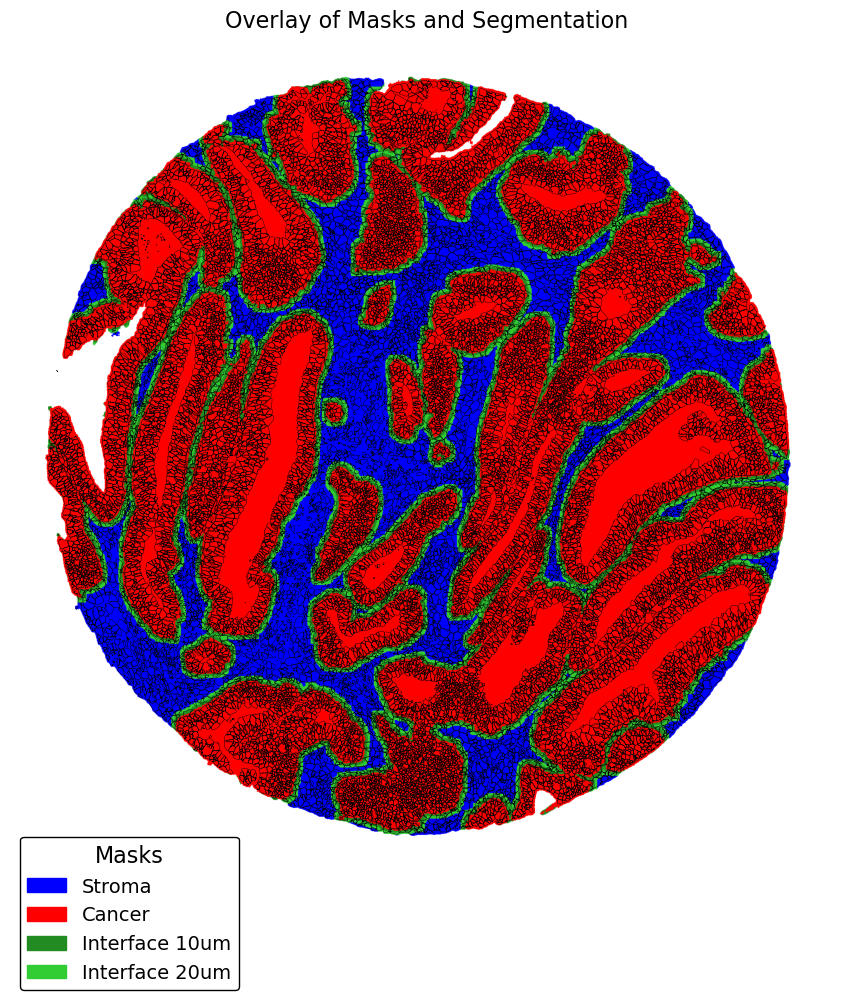

In [8]:
titles = ['Stroma', 'Cancer', 'Interface 10um', 'Interface 20um', ]
colors = ['blue', 'red', 'ForestGreen', 'LimeGreen', ] 
ov.plot_masks_overlay_segmentation(colors= colors,titles=titles)

Lets plot Color segmented polygons based on overlap percentage with specified masks.
Cancer in Reds colormap
Cancer interface masks in Greens
Strma in Blues cmap

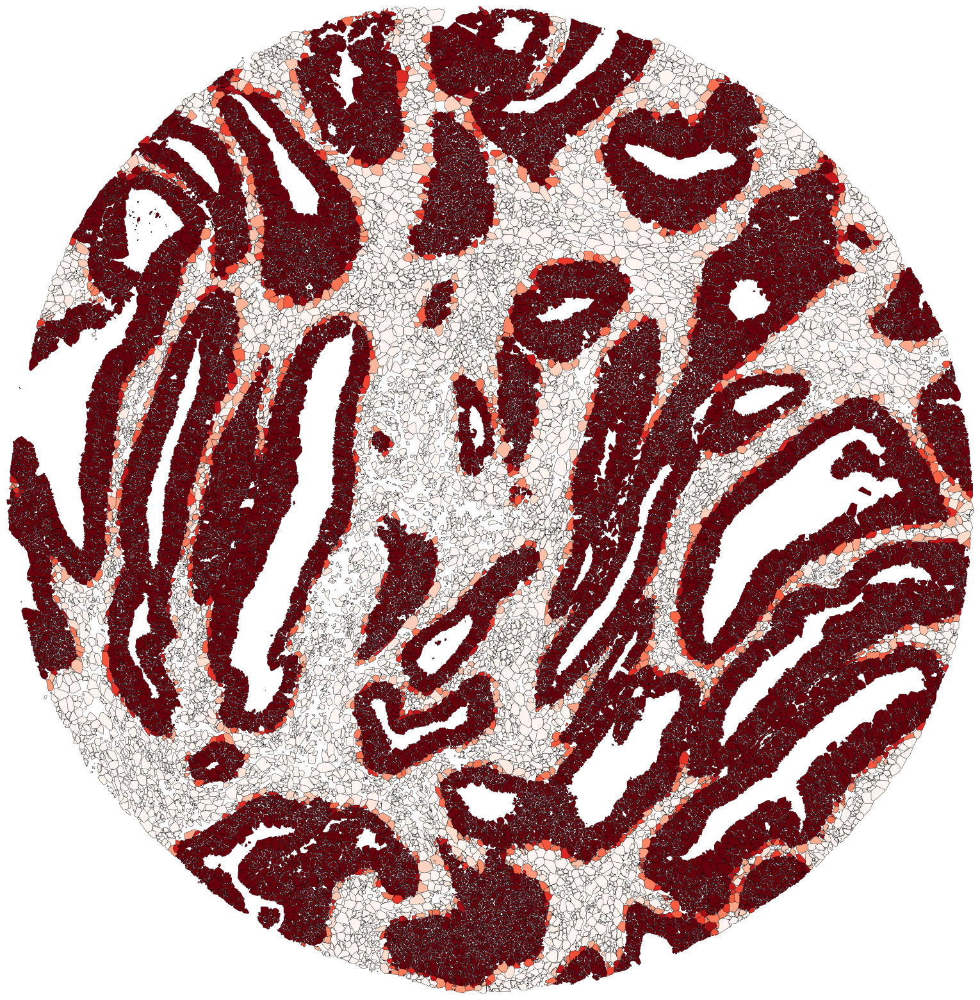

In [9]:
ov.plot_colored_by_mask_overlap(mask_to_color = ['Cancer'],
                                color_map='Reds', 
                                show=True, figsize = (20,20))

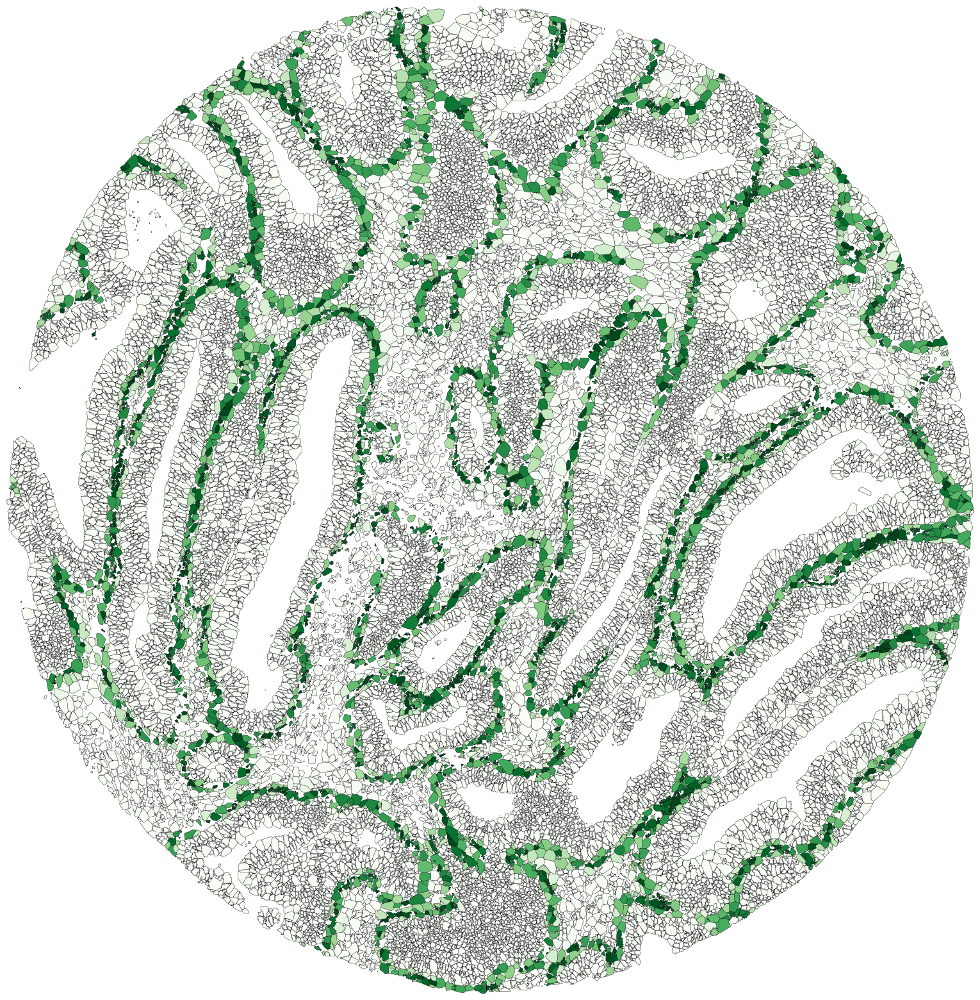

In [10]:
ov.plot_colored_by_mask_overlap(mask_to_color = ['Interface 10um', 'Interface 20um'], 
    color_map = 'Greens', show=True, figsize = (20,20))

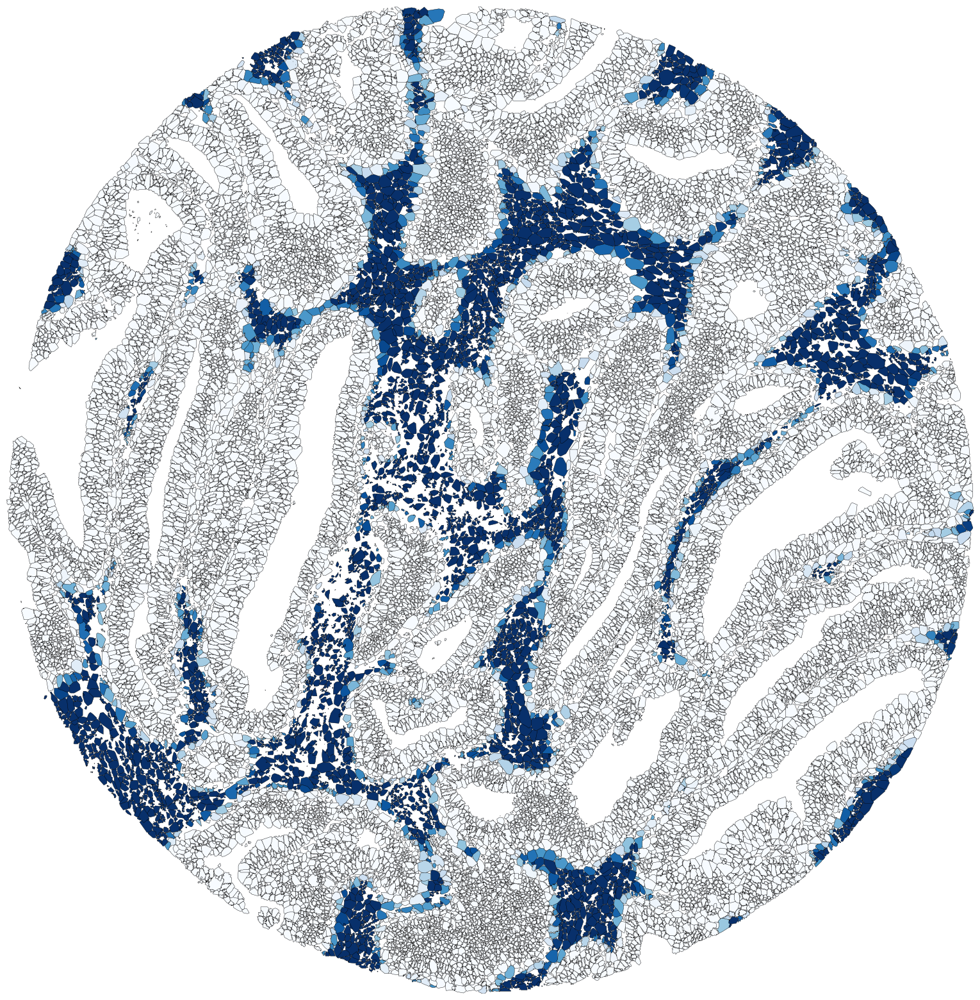

In [14]:
ov.plot_colored_by_mask_overlap(mask_to_color = ['Stroma'],
                                color_map = 'Blues',
                               show=True, figsize = (20,20))

***Relation to cell annotation***

We can check how the masks relate to the annotation of cells. Cells from segmentation were preprocessed and annotated using the standard practices of single-cell data (check paper). 

We will first open the adata file and grab the cells from this selection

In [15]:
adata_file = '../../xenium/HLA_analysis/cell_prior07_v20_03.h5ad'
adata = ad.read_h5ad(adata_file)
adata.obs['cellID'] = adata.obs['Name'].str.split('-').str[1].astype(int)
adata.obs['Selection'] = adata.obs['Selection'].str.replace(" ", "")
adata_selection = adata[adata.obs['XENIUM_TMA']== f'TMA{tma_number}']
adata_selection = adata_selection[adata_selection.obs['Selection']== f'Selection{selection_number}']

In [16]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image, ImageDraw
from matplotlib.colors import ListedColormap
from matplotlib import patches as mpatches
from matplotlib.colors import Normalize

def plot_polygons_categorical_annotation(geojson_data, adata, annotation_col, color_mapping, title, min_x, min_y):
    polygons_baysor_cellprior = [geometry['coordinates'][0] for geometry in geojson_data['geometries']]
    cell_ids = [int(geometry['cell']) for geometry in geojson_data['geometries']]

    fig, ax = plt.subplots(1, 1, figsize=(15, 15))

    for polygon, cell_id in zip(polygons_baysor_cellprior, cell_ids):
        polygon = np.array(polygon)
        if min_x is not None and min_y is not None:
            polygon = polygon - np.array([min_x, min_y])  # Shift the polygon coordinates
        if cell_id in adata.obs['cellID'].values:
            annotation = adata.obs.loc[adata.obs['cellID'] == cell_id, annotation_col].values[0]
        else: annotation = None    
        # Get the fill color for the annotation
        fill_color = color_mapping.get(annotation, 'grey')
        plt.plot(polygon[:, 0], polygon[:, 1], color='black', linewidth=0.3)
        plt.fill(polygon[:, 0], polygon[:, 1], color=fill_color)

    plt.title(title)

    # Create legend handles
    legend_handles = [mpatches.Patch(color=color, label=label) for label, color in color_mapping.items()]
    
    # Create the legend
    # plt.figure(figsize=(3, 3))  # Adjust as needed
    plt.legend(handles=legend_handles, loc='lower right')
    plt.axis('off')  # Hide axes

    plt.show()

We will check first the broad annotation in Stroma/Epithelial cells. 
We can see a very good relation with the Stroma cancer masks derived with GRIDGEN.

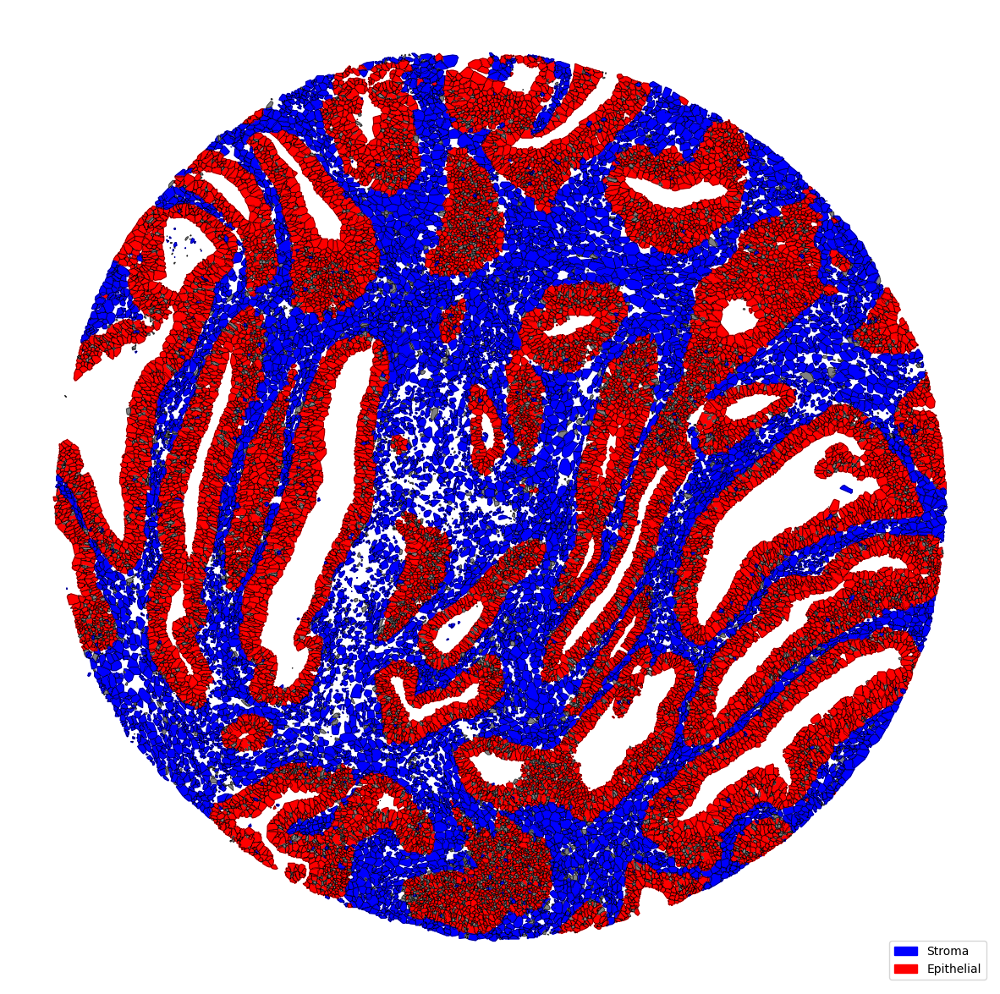

In [17]:
annotation_col = 'annotation_level0'
unique_annotations = adata.obs[annotation_col].unique()
colors = ['blue', 'red']
color_mapping = dict(zip(unique_annotations, colors))

plot_polygons_categorical_annotation(geojson_data, adata_selection, annotation_col, color_mapping, title='', min_x=min_x, min_y=min_y)

We will now zoom in on the immune cells.

To analyse this, we will add the percentage of each mask overlaping in the adata object and analyse it. 

In [22]:
for cell_id, masks in results.items():
    for mask_name, count in masks.items():
        # Create a new column for each mask
        column_name = f'{mask_name}_count'
        if column_name not in adata_selection.obs.columns:
            adata_selection.obs[column_name] = 0  # Initialize the column with zeros
        # Find the index of the cell in the DataFrame
        index = adata_selection.obs[adata_selection.obs['cellID'] == int(cell_id)].index
        # Update the count for the cell
        adata_selection.obs.loc[index, column_name] = count

CPU times: user 2 μs, sys: 0 ns, total: 2 μs
Wall time: 3.1 μs


In [26]:
mask_cols = ['Stroma_count', 'Cancer_count', 'Interface 10um_count', 'Interface 20um_count']
cell_type_col='pheno_HR_level2'

df = adata_selection.obs[[cell_type_col] + mask_cols].copy()
df['CI_combined'] = df['Interface 10um_count'] + df['Interface 20um_count']
mask_summary = df[['Stroma_count', 'Cancer_count', 'CI_combined']]
df['highest_mask'] = mask_summary.idxmax(axis=1)
df['highest_mask'] = df['highest_mask'].replace({
    'Stroma_count': 'Stroma',
    'Cancer_count': 'Cancer',
    'CI_combined': 'Interface'
})

adata_selection.obs['highest_mask'] = df['highest_mask']
df.head()

,pheno_HR_level2,Stroma_count,Cancer_count,Interface 10um_count,Interface 20um_count,CI_combined,highest_mask
CR6d7f00d5a-1_14_13,Myofibroblasts,48,0,0,0,0,Stroma
CR6d7f00d5a-2_14_13,Macrophages,51,0,0,0,0,Stroma
CR6d7f00d5a-3_14_13,Myofibroblasts,37,0,0,0,0,Stroma
CR6d7f00d5a-4_14_13,Fibroblasts,315,0,0,0,0,Stroma
CR6d7f00d5a-5_14_13,Glial Cells,9,0,0,0,0,Stroma


/tmp/ipykernel_3564450/3604474704.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  group_counts = df.groupby([cell_type_col, 'highest_mask']).size().unstack(fill_value=0)


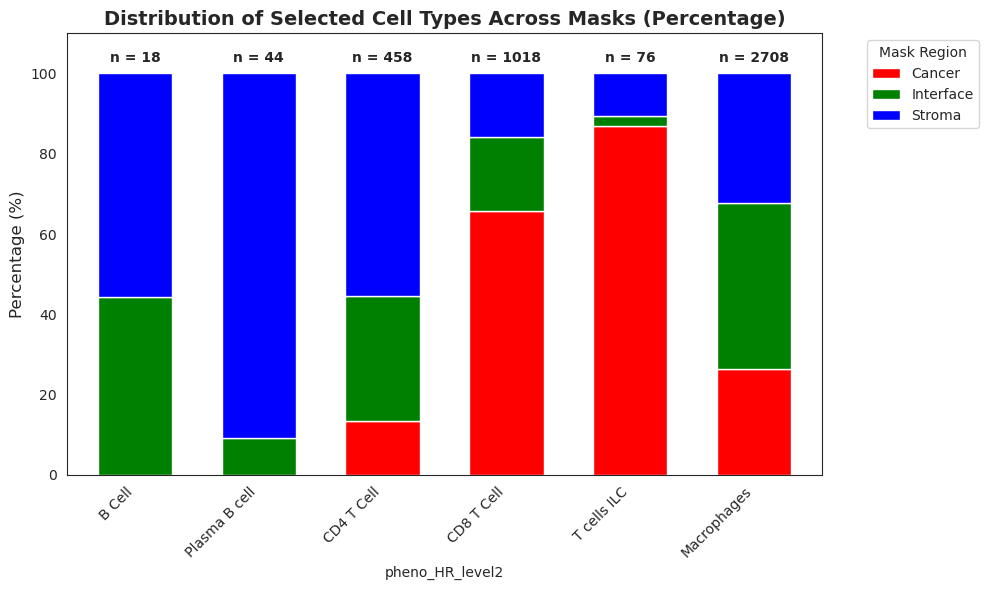

In [27]:
# Group by cell type + highest_mask and count
group_counts = df.groupby([cell_type_col, 'highest_mask']).size().unstack(fill_value=0)
group_counts['Total'] = group_counts.sum(axis=1)
group_percent = group_counts.div(group_counts['Total'], axis=0) * 100
group_percent = group_percent.drop(columns=['Total'])


selected_cell_types = ['B Cell','Plasma B cell', 'CD4 T Cell', 'CD8 T Cell', 'T cells ILC', 'Macrophages']
filtered_counts = group_counts.loc[selected_cell_types]
filtered_percent = group_percent.loc[selected_cell_types]


# PLOT
sns.set_style('white')
colors = ['red', 'green', 'blue'] 
ax = filtered_percent.plot(
    kind='bar',
    stacked=True,
    figsize=(10, 6),
    color=colors,
    width=0.6  # slightly narrower bars
)

plt.ylabel('Percentage (%)', fontsize=12)
plt.title('Distribution of Selected Cell Types Across Masks (Percentage)', fontsize=14, weight='bold')

# Move legend to right outside the plot
plt.legend(title='Mask Region', bbox_to_anchor=(1.05, 1), loc='upper left')
totals = filtered_counts.sum(axis=1) # Calculate total counts per cell type
# Add total counts as labels **above** each bar
for i, total in enumerate(totals):
    ax.text(i, 102, f'n = {int(total)}', ha='center', va='bottom', fontsize=10, weight='bold')
plt.ylim(0, 110)  # extend y-axis slightly for the labels
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.yticks(fontsize=10)
plt.tight_layout()
plt.savefig("results/distribution_cells.png", dpi = 500)
plt.show()


Lets look how different immune cells types are differentially distributed across the different tissue compartments

In [30]:
def plot_mask_results_cell(mask_dict, geojson_data_selection, results):
    fig, ax = plt.subplots(1, 1, figsize=(15, 15))

    # Define the color maps for each mask
    mask_color_maps = {
        'Interface 20um': 'Greens',
        'Interface 10um': 'Greens',
        'Stroma': 'Blues',
        'Cancer': 'Reds'
    }
    for feature in geojson_data_selection['geometries']:
        # Get the cell ID and polygon coordinates
        cell_id = int(feature['cell'])
        polygon = feature['coordinates'][0]
        # Get the results for this cell
        polygon_results = results.get(int(cell_id), {mask: 0 for mask in mask_dict.keys()})
        # Find the mask with the highest value
        highest_mask = max(polygon_results, key=polygon_results.get)
        # Get the color map for the highest mask
        color_map = mask_color_maps[highest_mask]
        # Calculate the percentage of pixels in the highest mask
        total_pixels = sum(polygon_results.values())
        percentage = (polygon_results[highest_mask] / total_pixels) * 100 if total_pixels != 0 else 0
        # Get a color from the color map based on the percentage
        color = plt.get_cmap(color_map)(Normalize(0, 100)(percentage))
        # Create a polygon and fill it with the color
        polygon_array = np.array(polygon)
        plt.plot(polygon_array[:, 0], polygon_array[:, 1], color=color, linewidth=0.3)
        polygon_patch = patches.Polygon(np.array(polygon), facecolor=color, edgecolor='black', linewidth=0.3)
        ax.add_patch(polygon_patch)
    plt.show()

***Distribution of B and Plasma B cells***

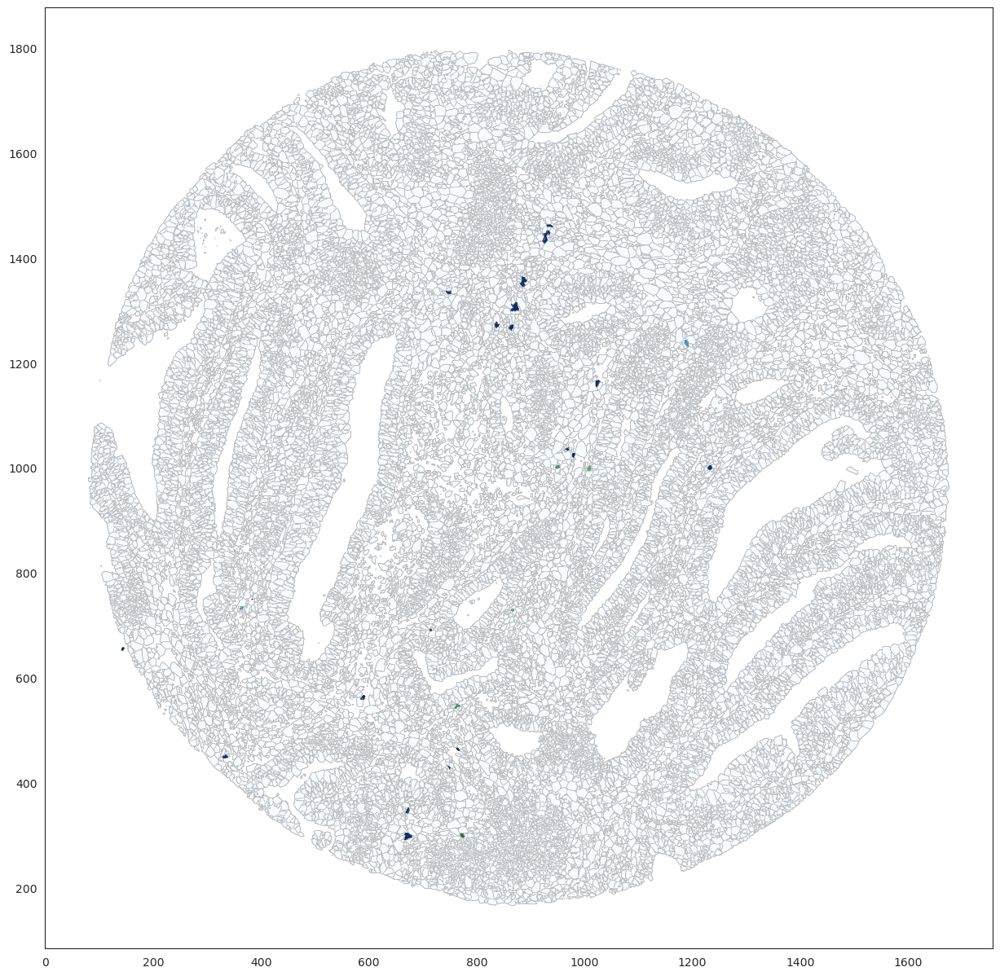

In [31]:
b_cells_annot = ['B Cell','Plasma B cell']
immune_cells_data = adata_selection[adata_selection.obs['pheno_HR_level2'].isin(b_cells_annot)]
immune_cell_ids = set(immune_cells_data.obs['cellID'].values)

results_immune = {int(cell_id): cell_results for cell_id, cell_results in results.items() if int(cell_id) in immune_cell_ids}
plot_mask_results_cell(mask_dict, geojson_data, results_immune)

***Distribution of CD4, CD8 and ILC T cells***

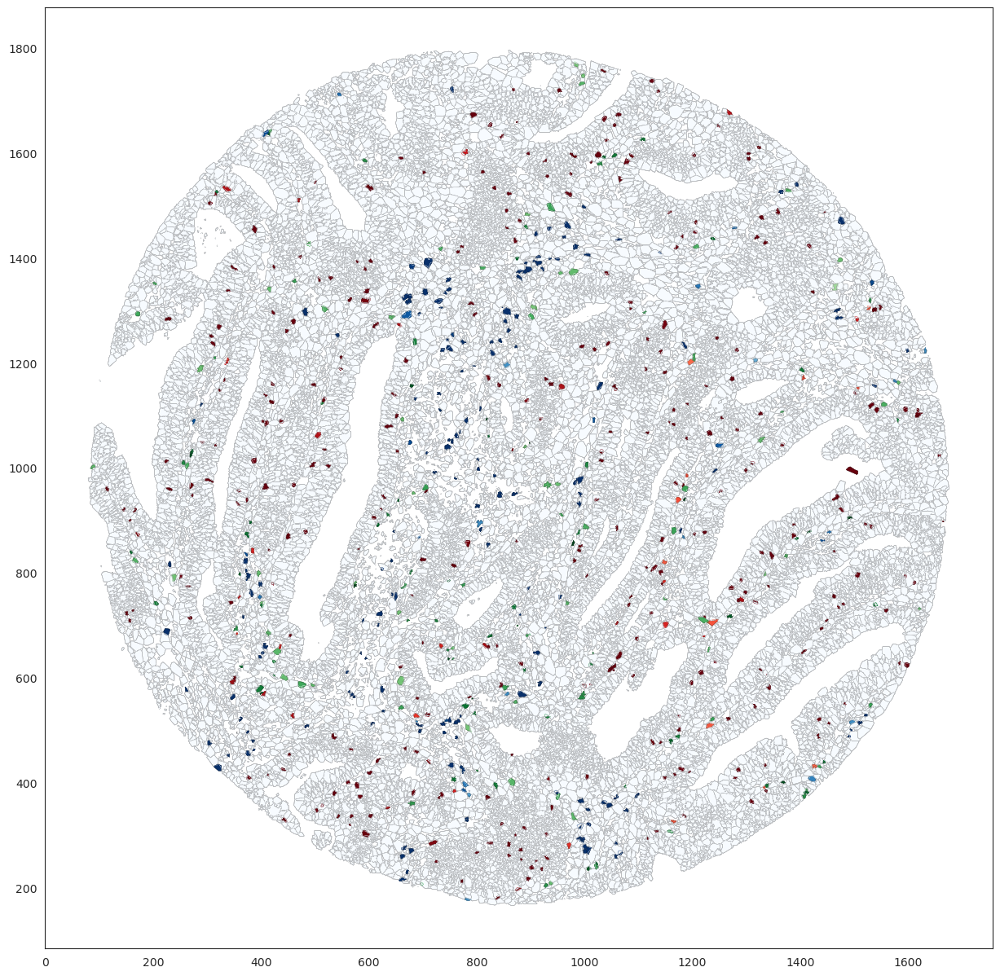

In [32]:
b_cells_annot = ['CD4 T Cell', 'CD8 T Cell', 'T cells ILC']
immune_cells_data = adata_selection[adata_selection.obs['pheno_HR_level2'].isin(b_cells_annot)]
immune_cell_ids = set(immune_cells_data.obs['cellID'].values)

results_immune = {int(cell_id): cell_results for cell_id, cell_results in results.items() if int(cell_id) in immune_cell_ids}
plot_mask_results_cell(mask_dict, geojson_data, results_immune)

***Distribution of Macrophages***

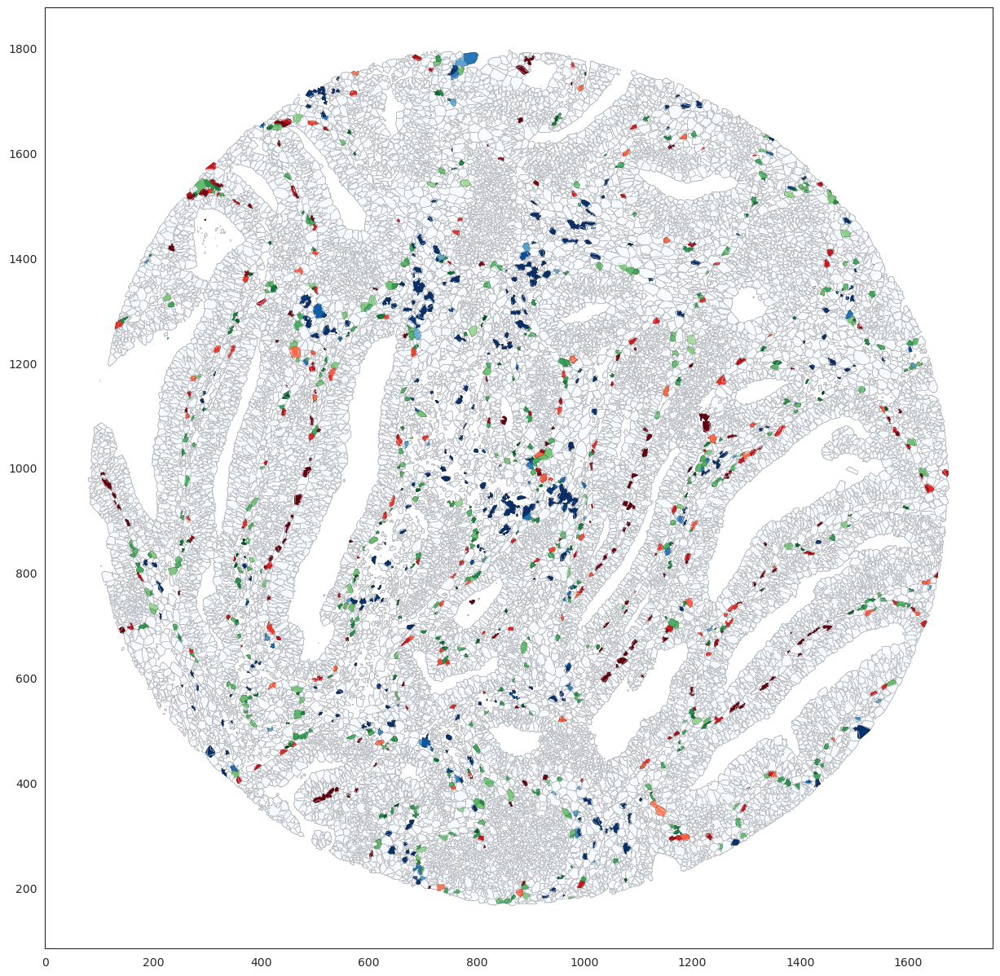

In [33]:
b_cells_annot = ['Macrophages']
immune_cells_data = adata_selection[adata_selection.obs['pheno_HR_level2'].isin(b_cells_annot)]
immune_cell_ids = set(immune_cells_data.obs['cellID'].values)

results_immune = {int(cell_id): cell_results for cell_id, cell_results in results.items() if int(cell_id) in immune_cell_ids}
plot_mask_results_cell(mask_dict, geojson_data, results_immune)